In [18]:
import cv2 # opencv
import numpy as np  
import os, sys
import matplotlib.pyplot as plt
import itertools
%matplotlib inline 
import time

In [2]:
def get_filenames(path, contains, does_not_contain=['~', '.pyc']):
    cmd = 'ls ' + '"' + path + '"'
    ls = os.popen(cmd).read()
    all_filelist = ls.split('\n')
    try:
        all_filelist.remove('')
    except:
        pass
    filelist = []
    for i, filename in enumerate(all_filelist):
        if contains in filename:
            fileok = True
            for nc in does_not_contain:
                if nc in filename:
                    fileok = False
            if fileok:
                filelist.append( os.path.join(path, filename) )
    return filelist
    
def load_image_file_and_convert_to_gray(filename): #square mask is trap-specific
    img = cv2.imread(filename)
    gimg = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # fill in top rows with black to hide timestamp
    gimg[0:100,:] = 0 # If moving wires are a problem, one solution is to mask them out in a similar way
    return gimg

def load_color_image(filename):
    img = cv2.imread(filename)
    return img

def load_mask(square_mask_path):
    mask = cv2.imread(square_mask_path)
    mask = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)
    mask = mask/255 #rescales mask to be 0s and 1s
    return mask

def load_image_file(filename):
    img = cv2.imread(filename)
    img[0:100,:] = 0
    return img

def load_image_stack(filelist):
    image_stack = []
    for filename in filelist:
        image_stack.append(load_image_file_and_convert_to_gray(filename))
    return image_stack

In [3]:
def fit_ellipse_to_contour(contour):
    M = cv2.moments(contour)
    if M['m00'] != 0:
        cx = int(M['m10']/M['m00']) # centroid, x
        cy = int(M['m01']/M['m00']) # centroid, y
        area = cv2.contourArea(contour)
        return cx, cy, area
    else:
        return None
    '''
    ellipse = cv2.fitEllipse(contour)
    (x,y), (a,b), angle = ellipse
    a /= 2.
    b /= 2.
    eccentricity = np.min((a,b)) / np.max((a,b))
    '''
    return cx, cy, area

def smooth_image(thresh_img):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    thresh_img_smooth = cv2.morphologyEx(thresh_img, cv2.MORPH_OPEN, kernel, iterations = 1)
    thresh_img_smooth = cv2.dilate(thresh_img_smooth, kernel, iterations=10) # make the contour bigger to join neighbors
    thresh_img_smooth = cv2.erode(thresh_img_smooth, kernel, iterations=10) # make contour smaller again
    return thresh_img_smooth

def get_contours_from_frame_and_stack(image_stack, frame_to_analyze, threshold=25):
    # get the median image
    med_img = np.median(image_stack, axis=0)
    
    # find all the dark objects in the image compared to the median
    thresh_img = cv2.compare(np.float32(image_stack[frame_to_analyze]), np.float32(med_img)-threshold, cv2.CMP_LT) 
    # CMP_LT is less than

    # smooth the image a little. play around with the kernel size (specified above) to get desired effect
    thresh_img_smooth = smooth_image(thresh_img)
    
    # grab the outer contour of the blobs. Note, this is for opencv version 3. 
    image, contours, hierarchy = cv2.findContours(thresh_img_smooth, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return contours

def count_flies(image_stack, frame_to_analyze, minimum_contour_size=50, maximum_contour_size=200, threshold=25):
    
    contours = get_contours_from_frame_and_stack(image_stack, frame_to_analyze, threshold=threshold)

    flies = []
    not_flies = []
    for contour in contours:
        if len(contour) > 5: # smaller contours can't be turned into ellipses. 
            x, y, area = fit_ellipse_to_contour(contour)
            #print 'Contour area: ', area
            fly = {'x': x, 'y': y, 'area': area} # this is a dictionary
            if area < maximum_contour_size and area > minimum_contour_size:
                flies.append(fly)
            else:
                not_flies.append(fly)
    #print 'There are ' + str(len(flies)) + ' flies in this frame.'
    #print 'There are ' + str(len(not_flies)) + ' other things in this frame.'
    return flies, not_flies
    
def show_image_with_circles_drawn_around_putative_flies(color_image, flies, not_flies, textstr):
    fig = plt.figure(figsize=(20,12)) 
    ax = fig.add_subplot(111)
    for fly in flies:
        cv2.circle(color_image, (fly['x'], fly['y']), 50, [0,255,0], 5)
        ax.text(fly['x']+50, fly['y']+50, str(fly['area']), color = ([0,1,0]))
    for not_fly in not_flies:
        cv2.circle(color_image, (not_fly['x'], not_fly['y']), 50, [255,0,0], 5)
        ax.text(not_fly['x']+50, not_fly['y']+50, str(not_fly['area']), color =([1,0,0]))
    ax.imshow(color_image, cmap='gray')
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    ax.text(0.5, 0.95, textstr, horizontalalignment='center',verticalalignment='center', transform=ax.transAxes, color = 'white', fontsize = 30)
    plt.tight_layout(pad=0.0, w_pad=0.0, h_pad=0.0)
    

In [4]:
directory = "./2019_month_date/trapcam_timelapse/trap_B"

filename_list = get_filenames(path = directory, contains = "tl", does_not_contain = ['th'])
square_mask = load_mask(square_mask_path = directory+'/mask.jpg')
masked_image_stack = []
for filename in filename_list:
#     gimg = load_image_file_and_convert_to_gray(filename)
#     masked_image_stack.append(gimg*square_mask)
    img = load_color_image(filename)
    masked_image_stack.append(cv2.bitwise_and(img,img,mask = square_mask))
print len(masked_image_stack)


60


In [5]:
def plot_two_frames(a, b):
    fig = plt.figure(figsize=(20,6)) # change the figsize to increase/decrease the image size
    ax = fig.add_subplot(121) # one axis
    ax.imshow(a, cmap='gray')
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

    ax2 = fig.add_subplot(122)
    ax2.imshow(b, cmap='gray')
    ax2.axes.get_xaxis().set_visible(False)
    ax2.axes.get_yaxis().set_visible(False)
    plt.tight_layout(pad=0.0, w_pad=0.0, h_pad=0.0)

In [6]:
def plot_one_frame(a):
    fig = plt.figure(figsize=(20,12)) # change the figsize to increase/decrease the image size
    ax = fig.add_subplot(111) # one axis
    ax.imshow(a, cmap='gray')
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)
    plt.tight_layout(pad=0.0, w_pad=0.0, h_pad=0.0)

In [27]:
def find_contours_using_pretrained_backsub_MOG2(full_image_stack,
                                                filename_stack,
                                                train_num,
                                                mahalanobis_squared_thresh,
                                                buffer_btw_training_and_test, #I'm adding this because flies often stand still on the trap-top
                                                minimum_contour_size,
                                                maximum_contour_size,
                                                plot_figures):

    fgbg = cv2.createBackgroundSubtractorMOG2(history =train_num, varThreshold = mahalanobis_squared_thresh, detectShadows = False) # history = train_num frames, threshold 16, detect shadows = false

    all_contour_areas = []
    for index, training_image in enumerate(full_image_stack):
        t0 = time.time()
        fgmask = fgbg.apply(training_image, None, -1) # TRAINING STEP.
        if index > train_num: # when current index is less than train_num, the model hasn't been trained on the specified number of frames. After this point, the declaration of history = train_num should make the model "forget" earlier frames so it works as a sliding window
            try:
                test_image = full_image_stack[index+buffer_btw_training_and_test]
            except:
                break
            fgmask1 = fgbg.apply(test_image, None, 0) # the 0 specifies that no learning is occurring
            t1 = time.time()
            fgmask1 = smooth_image(fgmask1)
            image, contours, hierarchy = cv2.findContours(fgmask1, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            flies = []
            not_flies = []
            
            #print 'time taken: ' + str(t1-t0)
            for contour in contours:
                if len(contour) > 5: # smaller contours can't be turned into ellipses. 
                    x, y, area = fit_ellipse_to_contour(contour)
                    fly = {'x': x, 'y': y, 'area': area} 
                    if area < maximum_contour_size and area > minimum_contour_size:
                        flies.append(fly)
                    else:
                        not_flies.append(fly)
                    all_contour_areas.append(area)
            if len(flies)> 0:
                filename = filename_stack[index+buffer_btw_training_and_test].split('_')[-1].split('.')[0]
                test_image_copy = test_image.copy()
                if plot_figures:
                    show_image_with_circles_drawn_around_putative_flies(test_image_copy, flies, not_flies, textstr = filename)
                #plot_two_frames(test_image, fgmask1)
                    plot_one_frame(fgmask1)
    return flies, not_flies, all_contour_areas

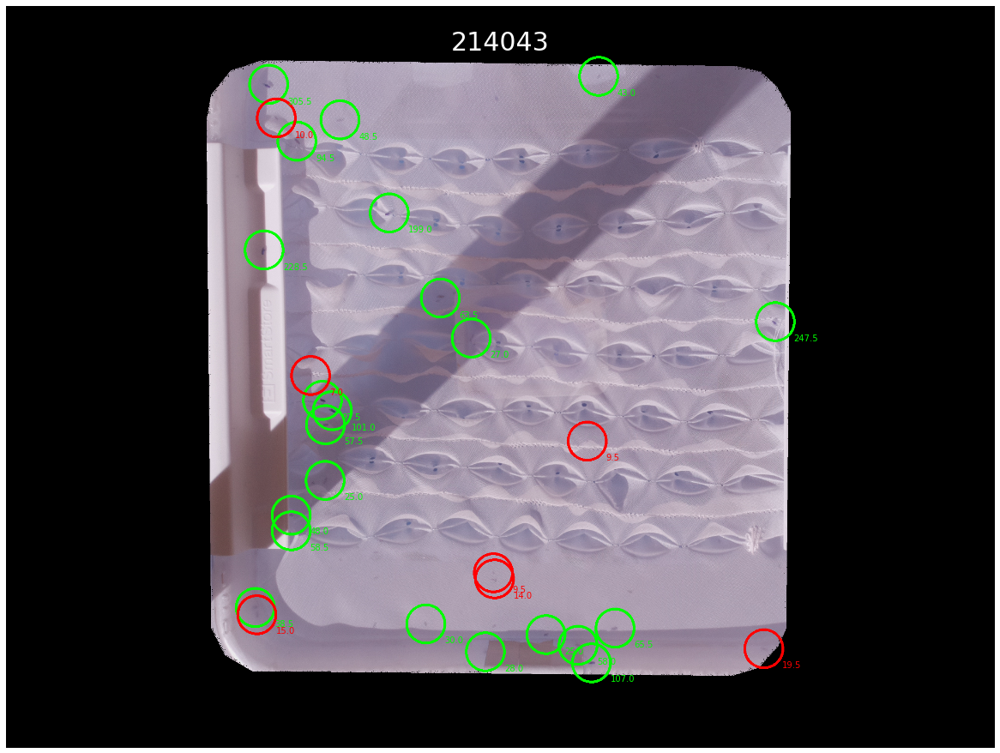

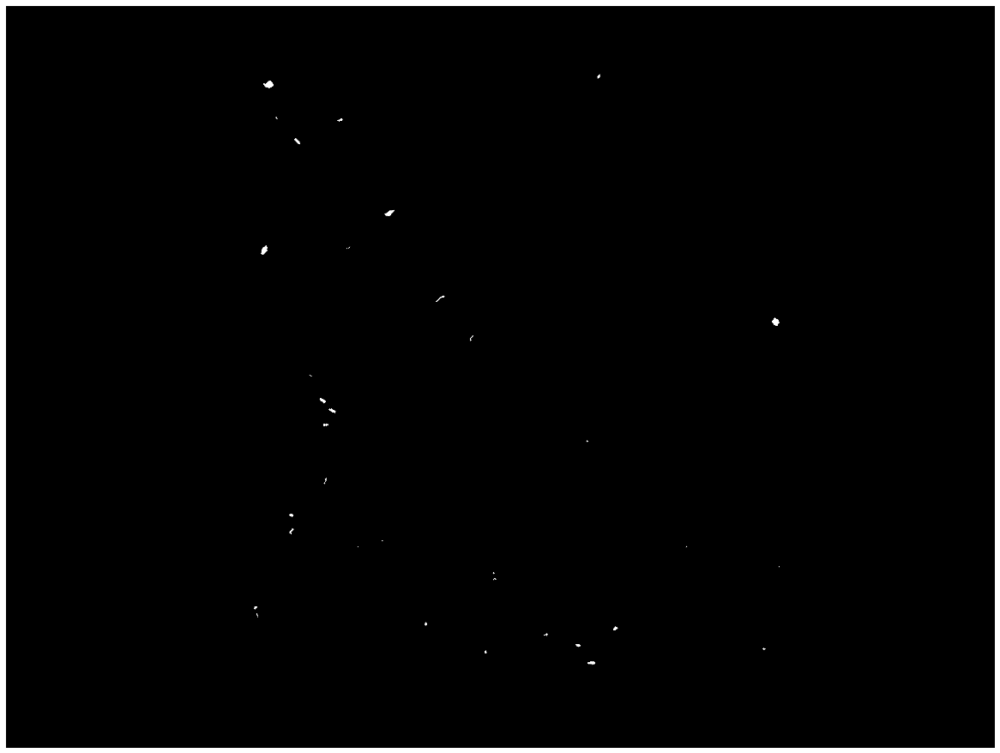

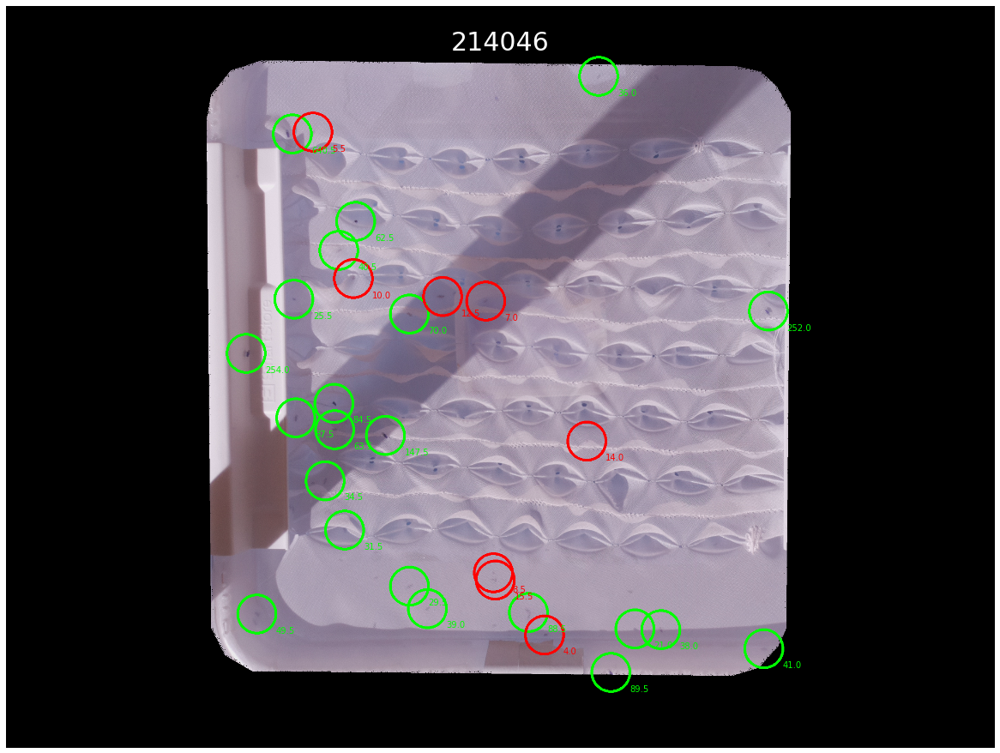

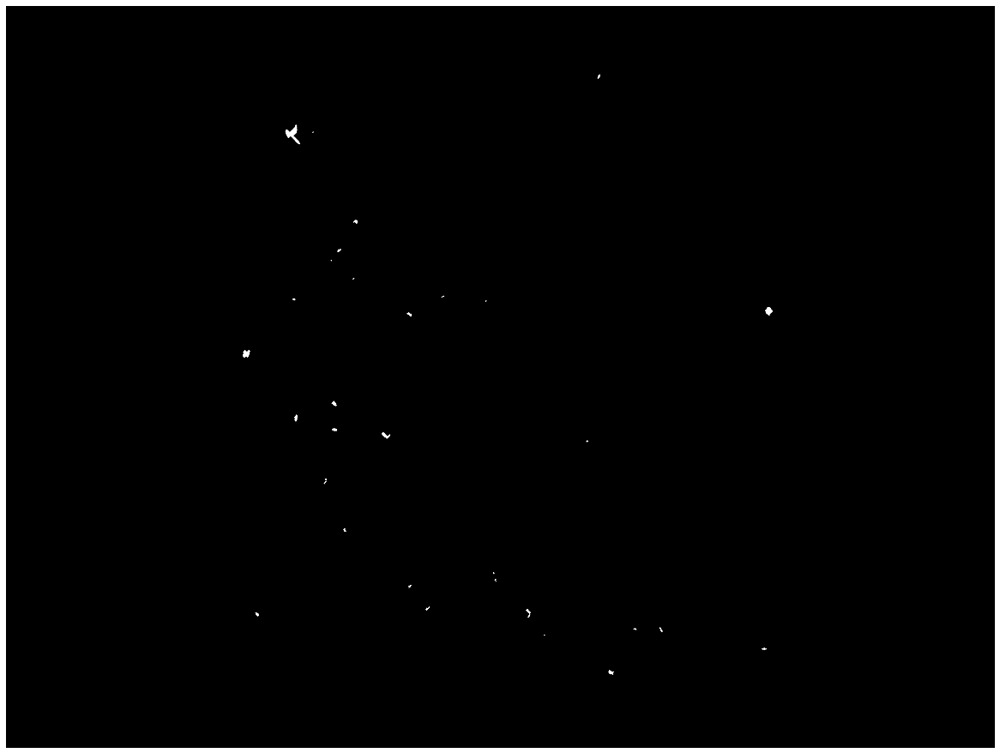

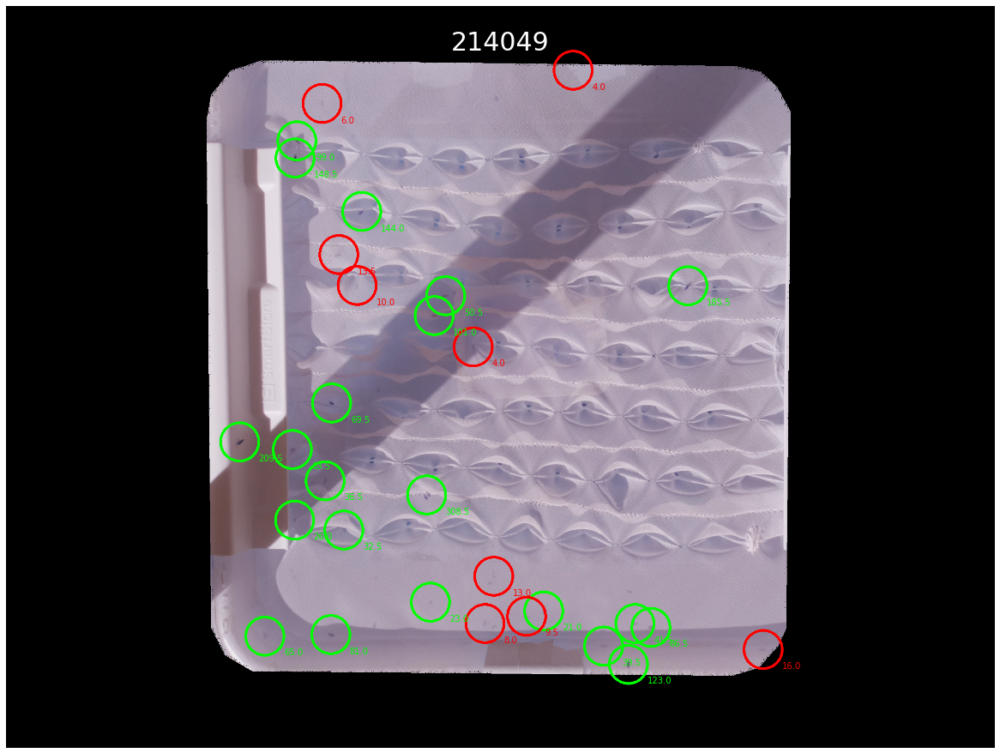

...

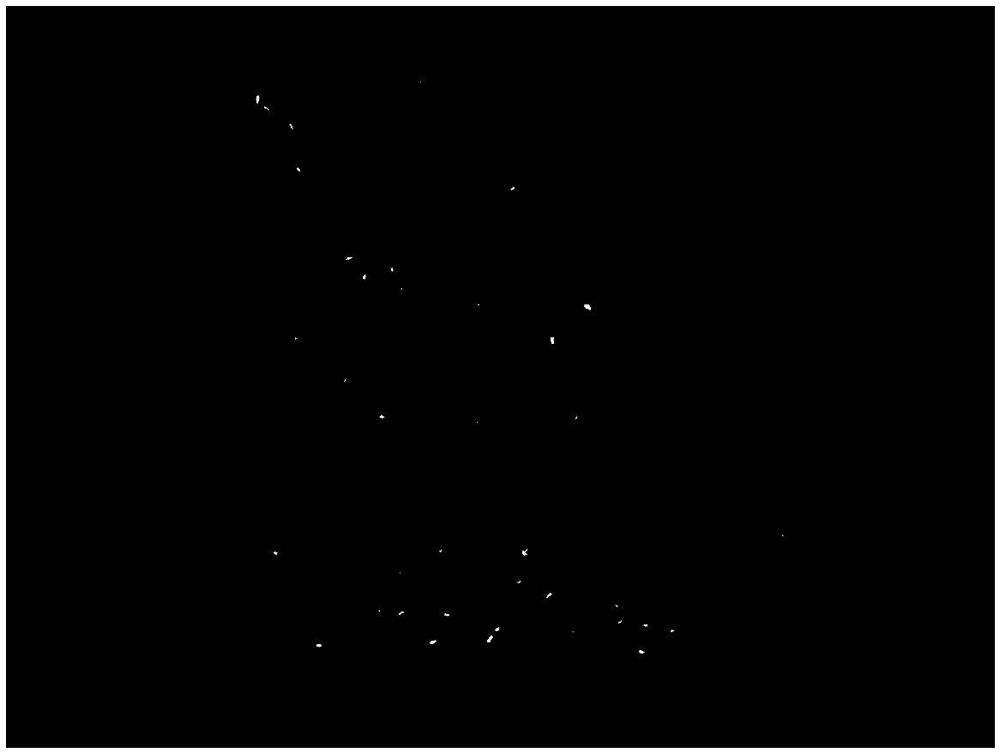

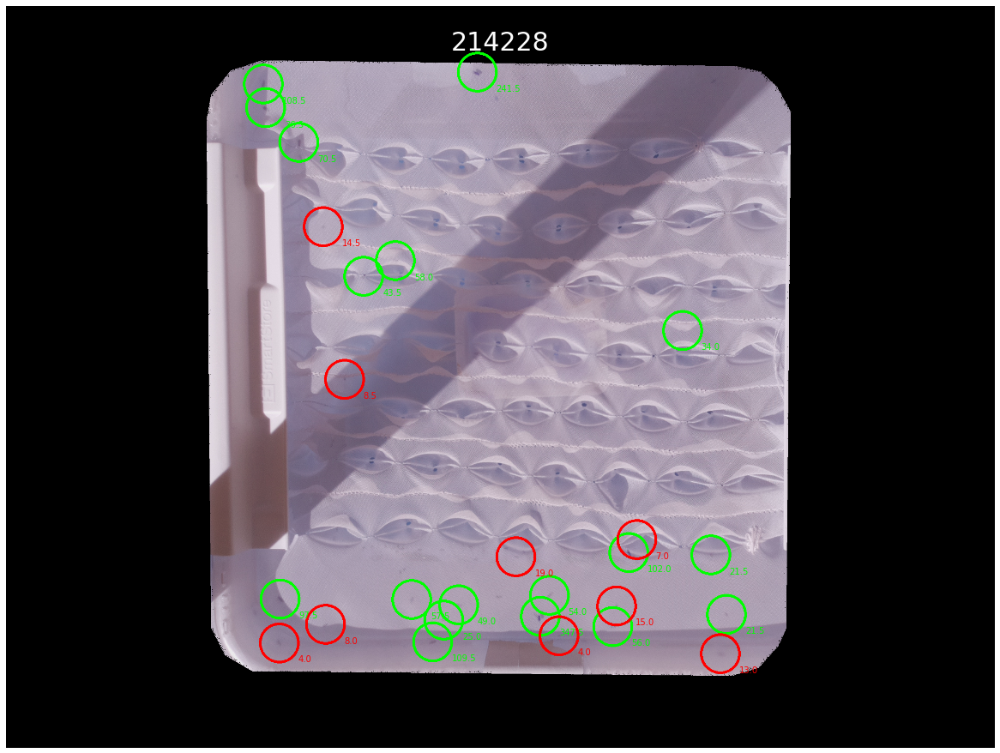

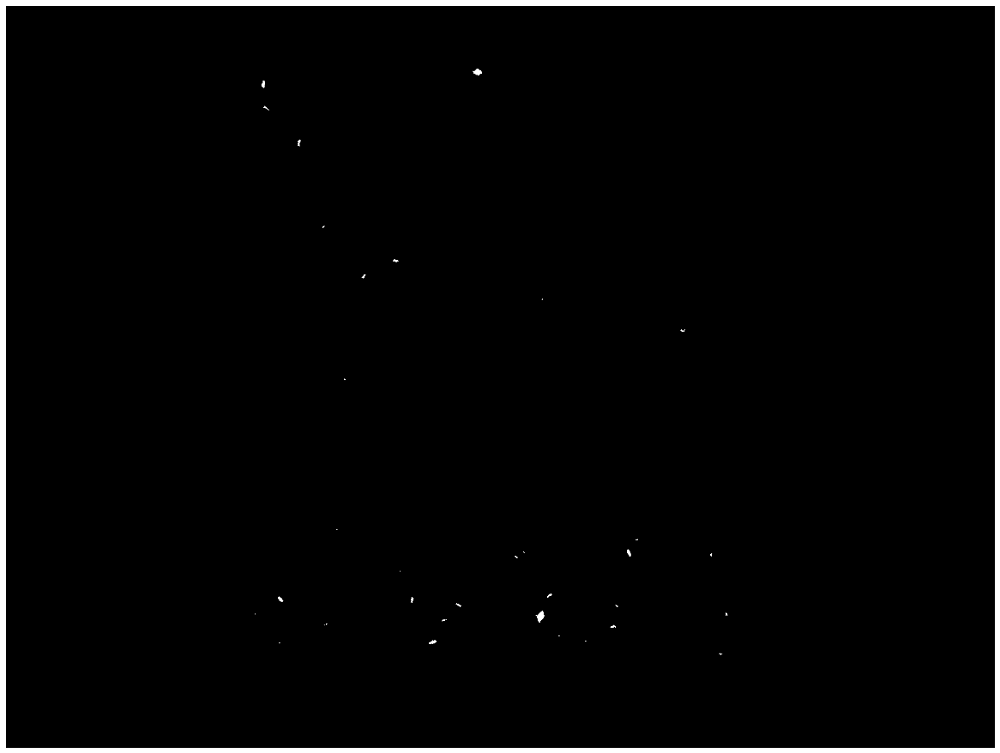

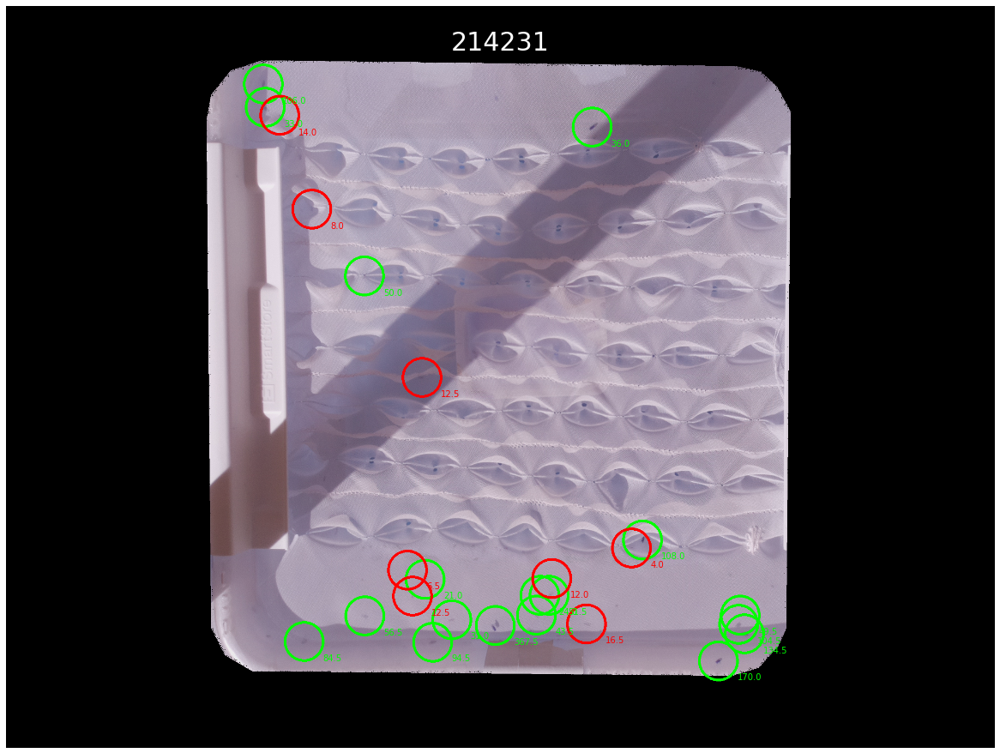

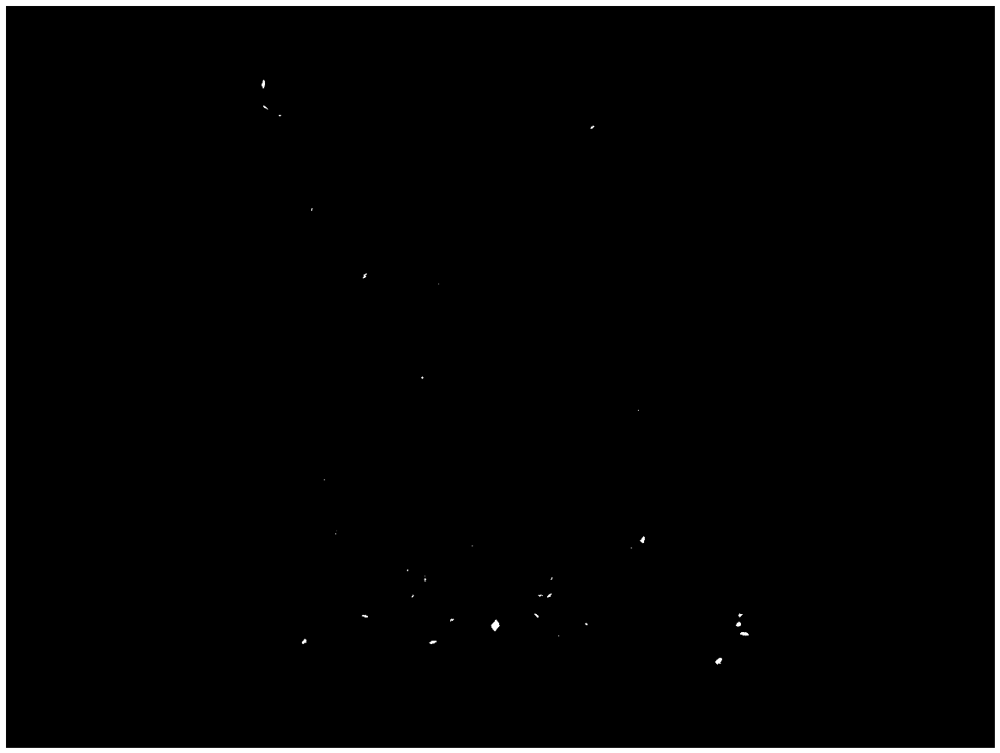

In [32]:
flies, not_flies, all_contour_areas = find_contours_using_pretrained_backsub_MOG2(full_image_stack = masked_image_stack, 
                                                           filename_stack = filename_list,
                                                           train_num = 20,
                                                           mahalanobis_squared_thresh = 20,
                                                           buffer_btw_training_and_test = 2, # if this number is too high, shadows become a problem due to the pesky spin of earth
                                                           minimum_contour_size = 20, 
                                                           maximum_contour_size = 1000,
                                                           plot_figures = True)

In [15]:
mahalan_list = [10,11,12,14,16,18,20,22,24,25,28,30, 32, 34, 40, 45, 50]
total_contours_list = []
for mahalan in mahalan_list:
    flies, not_flies, all_contour_areas = find_contours_using_pretrained_backsub_MOG2(full_image_stack = masked_image_stack, 
                                                               filename_stack = filename_list,
                                                               train_num = 20,
                                                               mahalanobis_squared_thresh = mahalan,
                                                               buffer_btw_training_and_test = 3, 
                                                               minimum_contour_size = 30, 
                                                               maximum_contour_size = 1000,
                                                               plot_figures = False)
    total_contours_list.append(all_contour_areas)

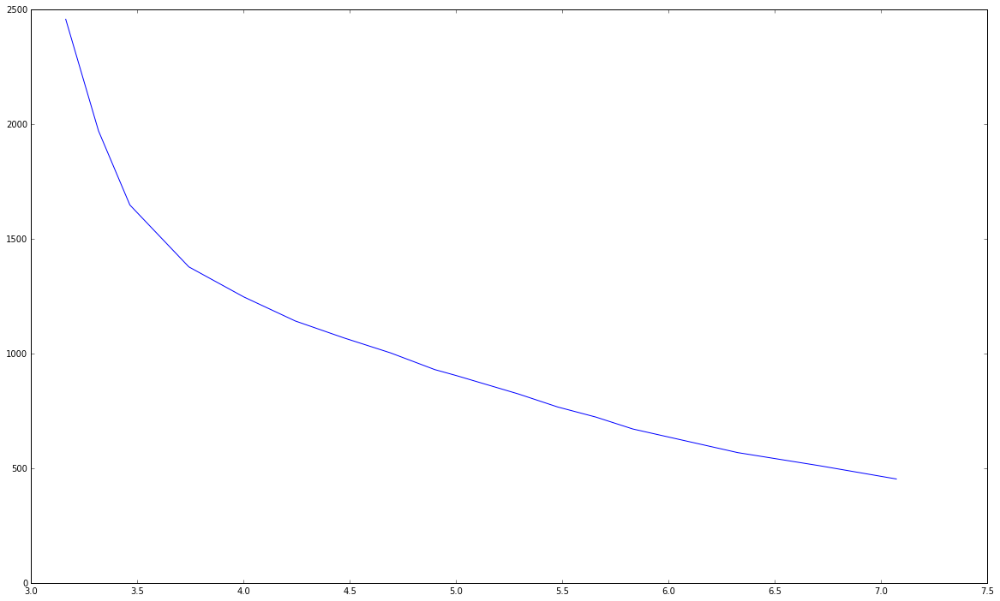

In [16]:
fig = plt.figure(figsize=(20,12)) # change the figsize to increase/decrease the image size
ax = fig.add_subplot(111) # one axis
ax.plot([np.sqrt(x) for x in mahalan_list], [len(i) for i in total_contours_list])
